<a href="https://colab.research.google.com/github/Sambhav1207/Deep-Learning-Projects/blob/main/Dog_vs_Cat_Classification_Transfer_Learning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Dog vs Cat Classification Transfer Learning

##Extracting Dataset using Kaggle API

In [1]:
!pip install kaggle

In [2]:
!mkdir ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

##Importing Dog vs Cat Dataset from Kaggle

In [3]:
!kaggle competitions download -c dogs-vs-cats

 99% 804M/812M [00:06<00:00, 149MB/s]
100% 812M/812M [00:06<00:00, 127MB/s]


In [4]:
!ls

dogs-vs-cats.zip  kaggle.json  sample_data


In [5]:
#Extracting the Compressed Dataset
from zipfile import ZipFile
dataset = "/content/dogs-vs-cats.zip"

with ZipFile(dataset, 'r') as zip:
  zip.extractall()
  print("Done")

Done


In [6]:
#Extracting the Compressed Dataset
from zipfile import ZipFile

dataset = '/content/train.zip'

with ZipFile(dataset, 'r') as zip:
  zip.extractall()
  print('The dataset is extracted')

The dataset is extracted


In [7]:
import os
#Counting the Number of Files in Train Folder
path, dirs, files = next(os.walk('/content/train'))
file_count = len(files)
print("Number of Images:", file_count)

Number of Images: 25000


In [8]:
#Printing the Names of the Images
file_names = os.listdir('/content/train')
print(file_names)

['cat.7033.jpg', 'dog.7542.jpg', 'dog.5331.jpg', 'cat.9750.jpg', 'cat.2347.jpg', 'cat.5780.jpg', 'dog.5267.jpg', 'cat.10778.jpg', 'cat.2250.jpg', 'dog.10545.jpg', 'dog.4604.jpg', 'dog.3227.jpg', 'cat.4981.jpg', 'cat.10564.jpg', 'cat.7236.jpg', 'cat.5088.jpg', 'dog.11506.jpg', 'cat.1629.jpg', 'cat.12382.jpg', 'cat.8020.jpg', 'dog.3271.jpg', 'cat.8836.jpg', 'cat.11375.jpg', 'dog.7822.jpg', 'cat.6450.jpg', 'cat.1266.jpg', 'dog.3046.jpg', 'cat.11515.jpg', 'cat.6983.jpg', 'cat.1878.jpg', 'dog.5839.jpg', 'cat.1468.jpg', 'dog.10198.jpg', 'dog.2339.jpg', 'dog.12287.jpg', 'cat.4357.jpg', 'cat.1039.jpg', 'dog.9742.jpg', 'cat.2840.jpg', 'cat.10152.jpg', 'cat.10391.jpg', 'dog.9326.jpg', 'cat.2890.jpg', 'dog.5120.jpg', 'dog.12306.jpg', 'cat.618.jpg', 'dog.6592.jpg', 'cat.354.jpg', 'dog.4667.jpg', 'cat.8652.jpg', 'dog.10265.jpg', 'dog.2964.jpg', 'cat.4807.jpg', 'cat.1293.jpg', 'cat.4390.jpg', 'cat.1979.jpg', 'cat.2767.jpg', 'cat.10815.jpg', 'cat.11999.jpg', 'dog.185.jpg', 'dog.8197.jpg', 'cat.5812.j

##Importing the Dependencies

In [9]:
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from sklearn.model_selection import train_test_split
from google.colab.patches import cv2_imshow

##Displaying the Images of Dogs and Cats

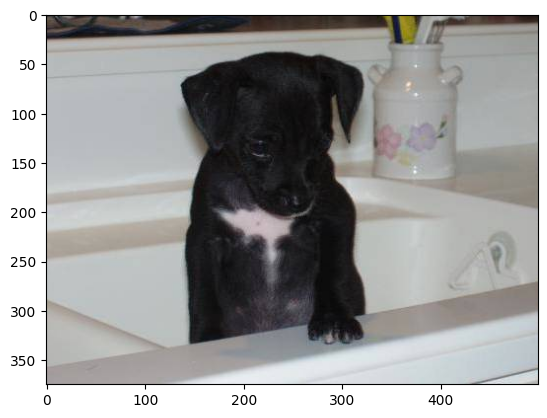

In [10]:
#Display Dog Image
img = mpimg.imread('/content/train/dog.8298.jpg')
imgplot = plt.imshow(img)
plt.show()

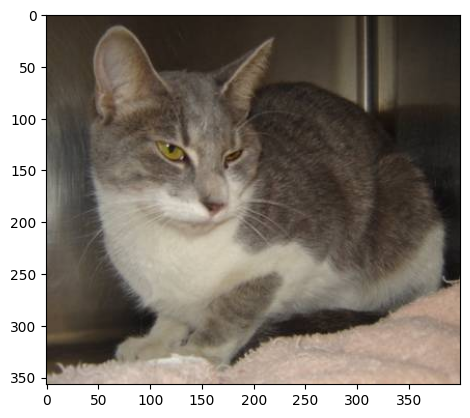

In [11]:
#Display Cat Image
img = mpimg.imread('/content/train/cat.4352.jpg')
imgplot = plt.imshow(img)
plt.show()

In [12]:
file_names = os.listdir('/content/train')
for i in range(5):
  name = file_names[i]
  print(name[0:3])

cat
dog
dog
cat
cat


In [13]:
file_names = os.listdir('/content/train')
dog_count = 0
cat_count = 0
for img_file in file_names:
  name = img_file[0:3]
  if name == 'dog':
    dog_count += 1
  else:
    cat_count += 1
print("Dog Count:", dog_count)
print("Cat Count:", cat_count)

Dog Count: 12500
Cat Count: 12500


##Resizing All the Images

In [17]:
#Creating a Directory for Resized Images
os.mkdir('/content/image resized')

In [22]:
original_folder = '/content/train/'
resized_folder = '/content/image resized/'

for i in range(2000):

  filename = os.listdir(original_folder)[i]
  img_path = original_folder+filename

  img = Image.open(img_path)
  img = img.resize((224, 224))
  img = img.convert('RGB')

  newImgPath = resized_folder+filename
  img.save(newImgPath)

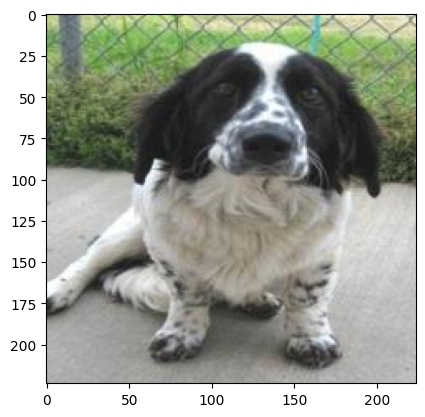

In [25]:
#Display Resized Dog Image
img = mpimg.imread('/content/image_resized/dog.10082.jpg')
imgplt = plt.imshow(img)
plt.show()

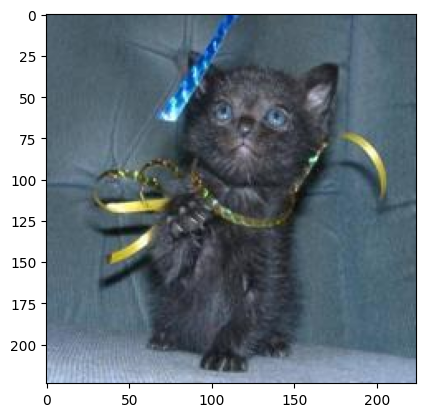

In [27]:
#Display Resized Cat Image
img = mpimg.imread('/content/image resized/cat.10058.jpg')
imgplt = plt.imshow(img)
plt.show()

##Creating Labels for Images of Dogs and Cats

Cat --> 0

Dog --> 1

In [28]:
#Creaing a for Loop to Assign Labels
filenames = os.listdir('/content/image resized/')

labels = []

for i in range(2000):

  file_name = filenames[i]
  label = file_name[0:3]

  if label == 'dog':
    labels.append(1)

  else:
    labels.append(0)

In [29]:
print(filenames[0:5])
print(len(filenames))

['cat.7033.jpg', 'dog.7542.jpg', 'dog.5331.jpg', 'cat.9750.jpg', 'cat.2347.jpg']
2000


In [30]:
print(labels[0:5])
print(len(labels))

[0, 1, 1, 0, 0]
2000


##Converting all Resized Images to NumPy Arrays

In [31]:
import cv2
import glob

In [32]:
image_directory = '/content/image resized/'
image_extension = ['png', 'jpg']

files = []

[files.extend(glob.glob(image_directory + '*.' + e)) for e in image_extension]

dog_cat_images = np.asarray([cv2.imread(file) for file in files])

In [33]:
print(dog_cat_images)

[[[[168 154 132]
   [164 150 128]
   [165 151 129]
   ...
   [114 105 138]
   [103  93 129]
   [ 96  85 123]]

  [[170 156 134]
   [170 156 134]
   [170 156 134]
   ...
   [116 108 139]
   [113 104 137]
   [110 100 136]]

  [[169 155 133]
   [175 161 139]
   [178 164 142]
   ...
   [120 112 142]
   [118 110 141]
   [117 109 140]]

  ...

  [[ 87  84  79]
   [ 88  85  80]
   [ 89  86  81]
   ...
   [220 212 243]
   [222 214 245]
   [224 216 247]]

  [[ 86  82  77]
   [ 87  83  78]
   [ 88  85  77]
   ...
   [223 215 245]
   [221 213 243]
   [219 211 241]]

  [[ 83  79  74]
   [ 84  80  75]
   [ 86  83  75]
   ...
   [226 218 248]
   [221 213 243]
   [215 207 237]]]


 [[[ 42  68  85]
   [ 42  68  85]
   [ 40  66  83]
   ...
   [ 18  16  16]
   [ 24  22  12]
   [ 17  14   0]]

  [[ 43  69  85]
   [ 39  65  81]
   [ 34  60  76]
   ...
   [ 14  11  13]
   [ 21  18  10]
   [ 22  18   7]]

  [[ 40  68  79]
   [ 43  71  82]
   [ 43  71  82]
   ...
   [ 12   8  14]
   [ 14  10   9]
   [ 22  18

In [34]:
type(dog_cat_images)

numpy.ndarray

In [35]:
print(dog_cat_images.shape)

(2000, 224, 224, 3)


In [36]:
X = dog_cat_images
Y = np.asarray(labels)

##Train Test Split

In [37]:
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

In [38]:
print(X.shape, X_train.shape, X_test.shape)

(2000, 224, 224, 3) (1600, 224, 224, 3) (400, 224, 224, 3)


1600 --> Training Images

400 --> Test Images

In [39]:
#Scaling the Data
X_train_scaled = X_train/255
X_test_scaled = X_test/255

In [40]:
print(X_train_scaled)

[[[[0.88627451 0.93333333 0.93333333]
   [0.88627451 0.93333333 0.93333333]
   [0.89411765 0.93333333 0.93333333]
   ...
   [0.98039216 0.98823529 0.98823529]
   [0.98039216 0.98823529 0.98823529]
   [0.98039216 0.98823529 0.98823529]]

  [[0.91372549 0.96078431 0.96078431]
   [0.92156863 0.96862745 0.96862745]
   [0.9372549  0.97647059 0.97647059]
   ...
   [0.98431373 0.99215686 0.99215686]
   [0.98039216 0.98823529 0.98823529]
   [0.98039216 0.98823529 0.98823529]]

  [[0.91764706 0.96470588 0.96470588]
   [0.9254902  0.97254902 0.97254902]
   [0.9372549  0.98431373 0.98431373]
   ...
   [0.98431373 0.99215686 0.99215686]
   [0.98431373 0.99215686 0.99215686]
   [0.98039216 0.98823529 0.98823529]]

  ...

  [[0.50588235 0.61568627 0.73333333]
   [0.61960784 0.7372549  0.84313725]
   [0.64705882 0.76470588 0.87058824]
   ...
   [0.84313725 0.94509804 0.96862745]
   [0.83137255 0.93333333 0.95686275]
   [0.81960784 0.92156863 0.94509804]]

  [[0.50588235 0.60784314 0.7254902 ]
   [0.6

##Building the Neural Network

In [41]:
import tensorflow as tf
import tensorflow_hub as hub

In [42]:
mobilenet_model = 'https://tfhub.dev/google/tf2-preview/mobilenet_v2/feature_vector/4'
pretrained_model = hub.KerasLayer(mobilenet_model, input_shape=(224,224,3), trainable=False)

In [43]:
num_of_classes = 2
model = tf.keras.Sequential([
    pretrained_model,
    tf.keras.layers.Dense(num_of_classes)
])
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer (KerasLayer)    (None, 1280)              2257984   
                                                                 
 dense (Dense)               (None, 2)                 2562      
                                                                 
Total params: 2260546 (8.62 MB)
Trainable params: 2562 (10.01 KB)
Non-trainable params: 2257984 (8.61 MB)
_________________________________________________________________


In [44]:
model.compile(
    optimizer = 'adam',
    loss = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
    metrics = ['acc']
)

In [45]:
model.fit(X_train_scaled, Y_train, epochs=10)

Epoch 1/10
50/50 [==============================] - 76s 1s/step - loss: 0.2071 - acc: 0.9131
Epoch 2/10
50/50 [==============================] - 58s 1s/step - loss: 0.0692 - acc: 0.9787
Epoch 3/10
50/50 [==============================] - 57s 1s/step - loss: 0.0490 - acc: 0.9850
Epoch 4/10
50/50 [==============================] - 63s 1s/step - loss: 0.0383 - acc: 0.9900
Epoch 5/10
50/50 [==============================] - 61s 1s/step - loss: 0.0301 - acc: 0.9944
Epoch 6/10
50/50 [==============================] - 59s 1s/step - loss: 0.0253 - acc: 0.9950
Epoch 7/10
50/50 [==============================] - 60s 1s/step - loss: 0.0211 - acc: 0.9956
Epoch 8/10
50/50 [==============================] - 60s 1s/step - loss: 0.0183 - acc: 0.9969
Epoch 9/10
50/50 [==============================] - 60s 1s/step - loss: 0.0147 - acc: 0.9981
Epoch 10/10
50/50 [==============================] - 59s 1s/step - loss: 0.0131 - acc: 0.9994


In [46]:
score, acc = model.evaluate(X_test_scaled, Y_test)
print('Test Loss =', score)
print('Test Accuracy =', acc)

13/13 [==============================] - 19s 1s/step - loss: 0.0706 - acc: 0.9700
Test Loss = 0.07060651481151581
Test Accuracy = 0.9700000286102295


##Predictive System

Path of the image to be predicted: /content/dog.jpg


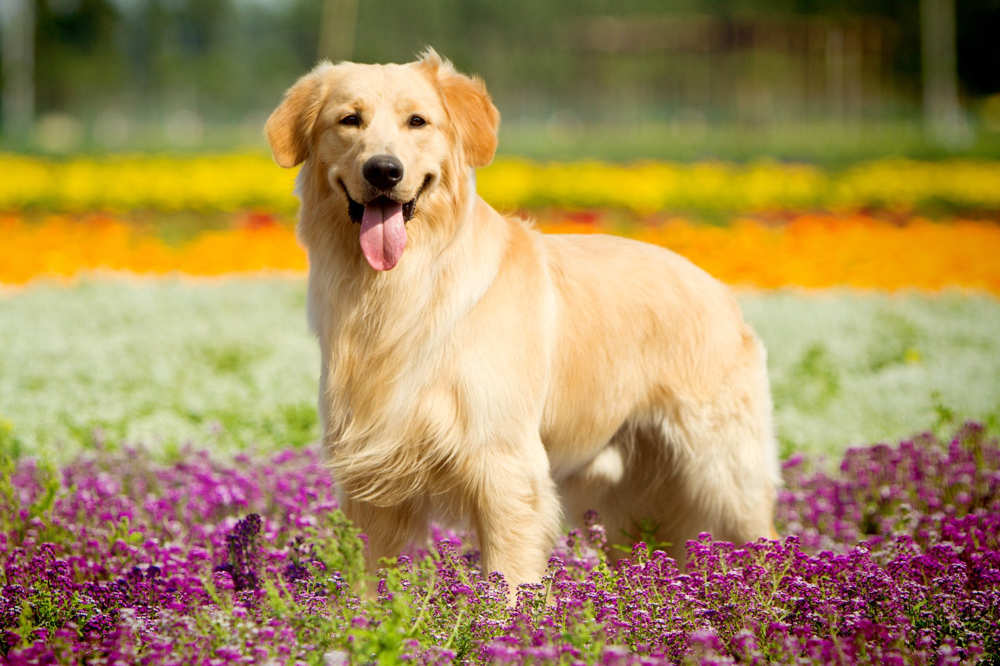

1/1 [==============================] - 1s 948ms/step
[[-4.4819865  6.5128484]]
1
The image represents a Dog


In [47]:
input_image_path = input('Path of the image to be predicted: ')
input_image = cv2.imread(input_image_path)
cv2_imshow(input_image)
input_image_resize = cv2.resize(input_image, (224,224))
input_image_scaled = input_image_resize/255
image_reshaped = np.reshape(input_image_scaled, [1,224,224,3])
input_prediction = model.predict(image_reshaped)
print(input_prediction)
input_pred_label = np.argmax(input_prediction)
print(input_pred_label)
if input_pred_label == 0:
  print('The image represents a Cat')
else:
  print('The image represents a Dog')

which is correct.

Path of the image to be predicted: /content/cat.jpg


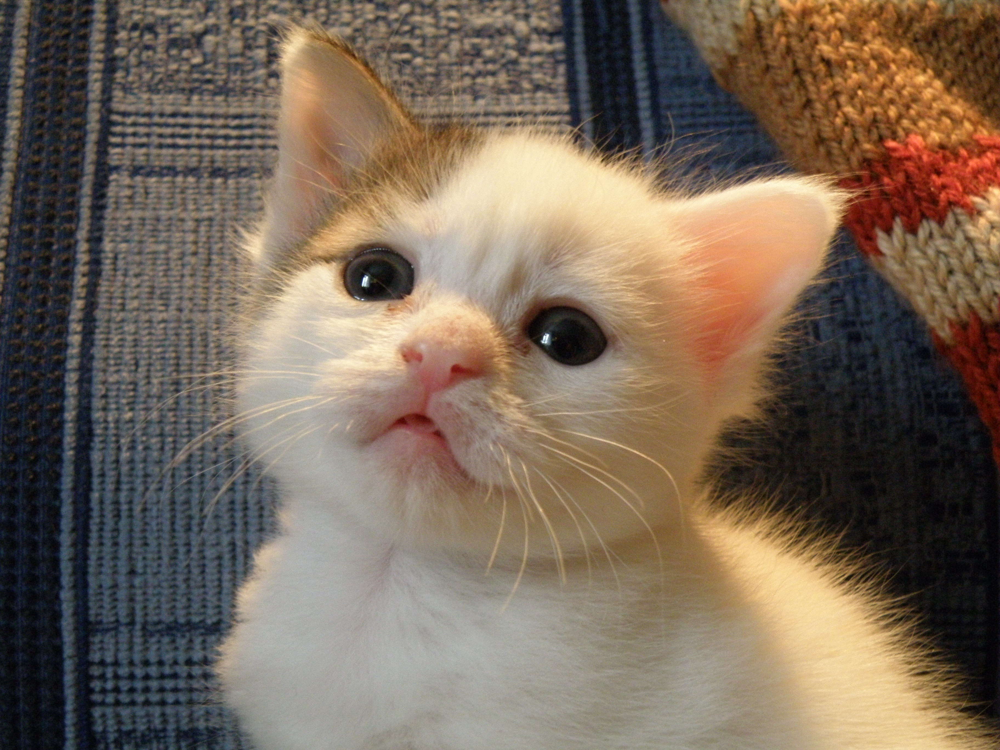

1/1 [==============================] - 0s 163ms/step
[[ 5.7226853 -5.435426 ]]
0
The image represents a Cat


In [48]:
input_image_path = input('Path of the image to be predicted: ')
input_image = cv2.imread(input_image_path)
cv2_imshow(input_image)
input_image_resize = cv2.resize(input_image, (224,224))
input_image_scaled = input_image_resize/255
image_reshaped = np.reshape(input_image_scaled, [1,224,224,3])
input_prediction = model.predict(image_reshaped)
print(input_prediction)
input_pred_label = np.argmax(input_prediction)
print(input_pred_label)
if input_pred_label == 0:
  print('The image represents a Cat')
else:
  print('The image represents a Dog')